<a href="https://colab.research.google.com/github/UMassIonTrappers/quantum-computing-labs/blob/main/Lab_04_RWA_Rabi_oscillations_and_detuning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ECE 550/650

## Introduction to Quantum Computing

Robert Niffenegger (rniffenegger@umass.edu )


In [56]:
try:
  import qutip
except ImportError:
  print('Install Qutip')
  !pip install qutip

try:
  import qiskit
except ImportError:
  print('Install Qiskit')
  !pip install -q qiskit
  !pip install -q qiskit[visualization]
  !pip install -q git+https://github.com/qiskit-community/qiskit-textbook.git#subdirectory=qiskit-textbook-src

### Initialize

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from numpy import pi, sqrt, sin, cos
plt.style.use('default') #background can be set to 'dark_backgound'...
linewidth = 4
figsize=5
ani_figsize = 3
fs=15

from pylab import *
import matplotlib.animation as animation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML, display, Math

#QuTiP
import qutip as qt
from qutip import *
from qutip.qip import *
from qutip import qeye, tensor, destroy, fock_dm
from qutip.qip.circuit import Gate
from qutip.qip.operations import *
from qutip.measurement import measure, measurement_statistics

#QISKIT
from qiskit import QuantumCircuit, transpile, assemble
from qiskit.visualization import plot_bloch_multivector, plot_histogram
from qiskit.quantum_info import Statevector
from qiskit_aer import QasmSimulator

#Future add: https://qopt.readthedocs.io/en/latest/examples/rabi_rwa.html

# Lab 5 part 1 - X vs Y pulses

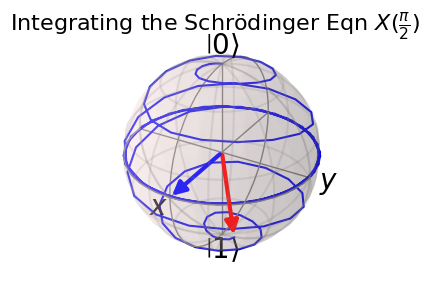

In [88]:
psi0 = spin_state( 1/2, 1/2) # Initialize the 'up' (|0>) state

Omega_Rabi = 2*pi*1 # 1 revolution / second = 2 pi radians / second
omega_z = 2*pi*10 # 10 revolution / second = 2 pi radians / second
delta = 0.0*2*pi # no detuning
omega_AC = omega_z + delta # omega_AC = omega_z when detuning is zero

H_z = 1/2*omega_z*sigmaz() # Hamiltonian for Z rotation from Zeeman splitting

args = {"t0":1e-3}

'''Time Dependent Hamiltonian from applied AC Bfield'''
def H1_coeff(t,args):
    t0=args['t0']
    return Omega_Rabi*np.sin(omega_AC*t+phase)

'''Adding static and dynamic Hamiltonians to numerically integrate the state trajectory'''
H_x = [H_z,[sigmax(),H1_coeff]]

'''Specify times to integrate over each Hamiltonian'''
t_steps = 40
BS1_times = np.linspace(0, 1/4, t_steps)    # 1/4 of 2pi = pi/2 rotation
Z_times = np.linspace(0, 1/4, t_steps)      # 1/2 of 2pi = pi   rotation
BS2_times = np.linspace(0, 1/4, t_steps)    # 1/4 of 2pi = pi/2 rotation

'''
Run the numerical integration of the Schrodinger Equation

    1. Beam splitter 1 ( pi/2 rotation about X)
    2. Phase rotation from detuning ( about Z)
    3. Beam splitter 2 ( pi/2 rotation about X)

    * Pass the wavefunction to each subsequent integration step
    * Append all of the expectation values

'''
expectation_values = []
result_1 = sesolve(H_x, psi0, BS1_times, e_ops=[sigmax(), sigmay(),sigmaz()], args=args)# Beam splitter #1
expectation_values_1 = result_1.expect
result_1 = sesolve(H_x, psi0, BS1_times, args=args)#run for final state

result_2 = sesolve(H_z, result_1.states[-1], Z_times,[sigmax(), sigmay(),sigmaz()])# Phase rotation about z from detuning
expectation_values_2 = result_2.expect
result_2 = sesolve(H_z, result_1.states[-1], Z_times)# run for final state

result_3 = sesolve(H_x, result_2.states[-1], BS2_times, [sigmax(), sigmay(),sigmaz()],args=args)# Beam Splitter #2
expectation_values_3 = result_3.expect
expectation_values = np.concatenate((expectation_values_1, expectation_values_2, expectation_values_3),axis=1)


'''Animate on the Bloch sphere'''
fig = plt.figure(figsize=(ani_figsize,ani_figsize))
fig.suptitle(r'Integrating the Schrödinger Equation', fontsize=16)
ax = fig.add_subplot(111, projection='3d') #MUST BE SUBPLOT --- WILL NOT WORK with 'Axes3d'!!!!!!
sphere = Bloch(axes=ax)
sphere.point_color = ['b']

#Animation function
def animate(i):
    sphere.clear()
    sphere.vector_color = ['b','r','grey','grey']

    if i < 1*t_steps:
        fig.suptitle(r'Integrating the Schrödinger Eqn $X(\frac{\pi}{2})$', fontsize=16)
        sphere.add_vectors([1,0,0]) #Add vector on X axis representing rotation axis

    elif i < 2*t_steps:
        fig.suptitle(r'Integrating the Schrödinger Eqn $Z(\pi)$', fontsize=16)
        sphere.add_vectors([0,0,1]) #Add vector on Z axis representing rotation axis

    else:
        fig.suptitle(r'Integrating the Schrödinger Eqn $X(\frac{\pi}{2})$', fontsize=16)
        sphere.add_vectors([1,0,0]) #Add vector on X axis representing rotation axis

    sphere.add_vectors([expectation_values[0][i],expectation_values[1][i],expectation_values[2][i]])
    sphere.add_points([expectation_values[0][:i+1],expectation_values[1][:i+1],expectation_values[2][:i+1]], meth='l')

    # sphere.add_points([sx[:i+1],sy[:i+1],sz[:i+1]], meth='l') #Point for each step of the rotation
    # sphere.add_vectors([sx[i],sy[i],sz[i]]) #Full vector from the simulation
    # sphere.add_vectors([0,sy[i],0]) #Y basis component
    # sphere.add_vectors([0,0,sz[i]]) #Z basis component
    sphere.make_sphere()
    return ax

def init():
    sphere.vector_color = ['r']
    return ax

ani = matplotlib.animation.FuncAnimation(fig, animate, np.arange(len(expectation_values[0])),init_func=init, blit=False, repeat=True)
# plt.close()  # Prevent display of static figure
HTML(ani.to_jshtml())

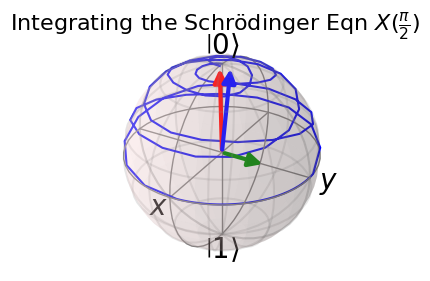

In [104]:
psi0 = spin_state( 1/2, 1/2) # Initialize the 'up' (|0>) state

Omega_Rabi = 2*pi*1 # 1 revolution / second = 2 pi radians / second
omega_z = 2*pi*10 # 10 revolution / second = 2 pi radians / second
delta = 0.0*2*pi # no detuning
omega_AC = omega_z + delta # omega_AC = omega_z when detuning is zero

H_z = 1/2*omega_z*sigmaz() # Hamiltonian for Z rotation from Zeeman splitting

args = {"t0":1e-3}


'''Time Dependent Hamiltonian from applied AC Bfield'''
def H1X_coeff(t,args):
    t0=args['t0']
    return Omega_Rabi*np.sin(omega_AC*t+0)


'''Time Dependent Hamiltonian from applied AC Bfield'''
def H1Y_coeff(t,args):
    t0=args['t0']
    return Omega_Rabi*np.sin(omega_AC*t+pi/2)

'''Adding static and dynamic Hamiltonians to numerically integrate the state trajectory'''
H_x = [H_z,[sigmax(),H1X_coeff]]

H_y = [H_z,[sigmax(),H1Y_coeff]]

'''Specify times to integrate over each Hamiltonian'''
t_steps = 40
BS1_times = np.linspace(0, 1/4, t_steps)    # 1/4 of 2pi = pi/2 rotation
Z_times = np.linspace(0, 1/4*1/10, t_steps)      # 1/2 of 2pi = pi   rotation
BS2_times = np.linspace(0, 1/4, t_steps)    # 1/4 of 2pi = pi/2 rotation
times = np.concatenate((BS1_times,Z_times,BS2_times))

'''
Run the numerical integration of the Schrodinger Equation

    1. Beam splitter 1 ( pi/2 rotation about X)
    2. Phase rotation from detuning ( about Z)
    3. Beam splitter 2 ( pi/2 rotation about X)

    * Pass the wavefunction to each subsequent integration step
    * Append all of the expectation values

'''
expectation_values = []
result_1 = sesolve(H_x, psi0, BS1_times, e_ops=[sigmax(), sigmay(),sigmaz()], args=args)# Beam splitter #1
expectation_values_1 = result_1.expect
result_1 = sesolve(H_x, psi0, BS1_times, args=args)#run for final state

result_2 = sesolve(H_z, result_1.states[-1], Z_times,[sigmax(), sigmay(),sigmaz()],args=args)# Phase rotation about z from detuning
expectation_values_2 = result_2.expect
result_2 = sesolve(H_z, result_1.states[-1], Z_times,args=args)# run for final state

result_3 = sesolve(H_y, result_2.states[-1], BS2_times, [sigmax(), sigmay(),sigmaz()],args=args)# Beam Splitter #2
expectation_values_3 = result_3.expect

expectation_values = np.concatenate((expectation_values_1, expectation_values_2,expectation_values_3),axis=1)


'''Animate on the Bloch sphere'''
fig = plt.figure(figsize=(ani_figsize,ani_figsize))
fig.suptitle(r'Integrating the Schrödinger Equation', fontsize=16)
ax = fig.add_subplot(111, projection='3d') #MUST BE SUBPLOT --- WILL NOT WORK with 'Axes3d'!!!!!!
sphere = Bloch(axes=ax)
sphere.point_color = ['b']

#Animation function
def animate(i):
    sphere.clear()
    sphere.vector_color = ['g','b','r']

    if i < 1*t_steps:
        fig.suptitle(r'Integrating the Schrödinger Eqn $X(\frac{\pi}{2})$', fontsize=16)
        # sphere.add_vectors([1,0,0]) #Add vector on X axis representing rotation axis
        sphere.add_vectors([0,-0.5*np.sin(omega_AC*times[i]),0]) #Perturbation field exaggerated 5X
        sphere.add_vectors([0,-0.1*np.sin(omega_AC*times[i]),1]) #Total rotation vector


    elif i < 2*t_steps:
        fig.suptitle(r'Integrating the Schrödinger Eqn $Z(\pi)$', fontsize=16)
        sphere.add_vectors([0,0.0*np.sin(omega_AC*times[i]),0]) #Perturbation field exaggerated 5X
        sphere.add_vectors([0,0,1]) #Add vector on Z axis representing rotation axis

    else:
        fig.suptitle(r'Integrating the Schrödinger Eqn $X(\frac{\pi}{2})$', fontsize=16)
        sphere.add_vectors([0,-0.5*np.sin(omega_AC*times[i]+pi/2),0]) #Perturbation field exaggerated 5X
        sphere.add_vectors([0,-0.1*np.sin(omega_AC*times[i]+pi/2),1]) #Total rotation vector

    sphere.add_vectors([expectation_values[0][i],expectation_values[1][i],expectation_values[2][i]])
    sphere.add_points([expectation_values[0][:i+1],expectation_values[1][:i+1],expectation_values[2][:i+1]], meth='l')


    sphere.make_sphere()
    return ax

def init():
    sphere.vector_color = ['r']
    return ax

ani = matplotlib.animation.FuncAnimation(fig, animate, np.arange(len(expectation_values[0])),init_func=init, blit=False, repeat=True)
# plt.close()  # Prevent display of static figure
HTML(ani.to_jshtml())

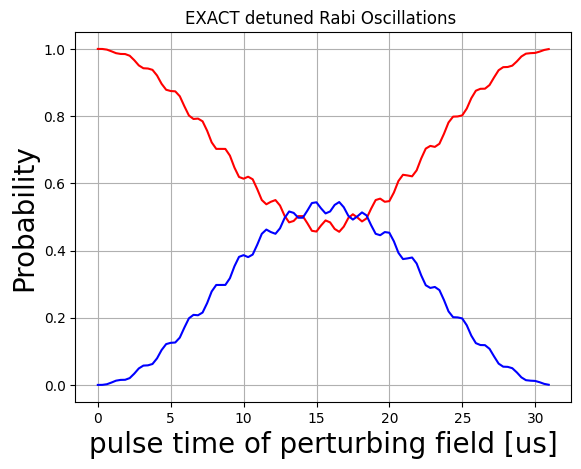

In [192]:
'''WEAKER quantization field to slow down omega_z to be closer to Omega_Rabi'''
Bfield_Z_weak = 1/10/1e4 # 0.1 Gauss (in units of Tesla)
omega_z_slow = const.value('Bohr magneton')*g_s*Bfield_Z_weak / const.hbar #units of radians/second

delta = Omega_Rabi_rads # Rabi coupling and detuning equal
omega_AC = omega_z_slow + delta


psi0 = spin_state( 1/2, +1/2) #initialize state

'''Setup the Hamiltonian'''
H0 = omega_z_slow/2 * sigmaz() #Energy of the Zeeman spin splitting

'''Time Dependent Hamiltonian from applied AC Bfield'''
def H1_coeff(t,args):
    t0=args['t0']
    return Omega_Rabi_rads*np.sin(omega_AC*t)

'''Adding static and dynamic Hamiltonians to numerically integrate the state trajectory'''
H = [H0,[sigmax(),H1_coeff]]


times=np.linspace(0, 0.707*period_Omega_Rabi, 100)
args = {"t0":1e-6}

result = mesolve(H, psi0, times, args=args)
sz =  expect(sigmaz(), result.states)
sy =  expect(sigmay(), result.states)
sx =  expect(sigmax(), result.states)
prob_up =  expect(psi_up*psi_up.dag(), result.states)#Extract the expectation values of being in each state
prob_down =  expect(psi_down*psi_down.dag(), result.states)

fig, ax = plt.subplots(1,1)
plt.grid()
ax.plot(times*1e6, prob_up,'-r')
ax.plot(times*1e6, prob_down,'-b')
plt.title('EXACT detuned Rabi Oscillations ')
ax.set_xlabel(r'pulse time of perturbing field [us]', fontsize=20)
ax.set_ylabel(r'Probability', fontsize=20)


'''Animate on the Bloch sphere'''
fig = plt.figure(figsize=(ani_figsize,ani_figsize))
fig.suptitle(r'Rotate at $\omega_{AC}=\omega_z+\delta$ :  $\delta = \Omega_R$', fontsize=fs*0.8)

ax = fig.add_subplot(111, projection='3d') #MUST BE SUBPLOT --- WILL NOT WORK with 'Axes3d'!!!!!!

sphere = Bloch(axes=ax)

def animate(i):
    sphere.clear()
    sphere.vector_color = ['r','green','blue']

    sphere.add_points([sx[:i+1],sy[:i+1],sz[:i+1]], meth='l') #Point for each step of the rotation
    sphere.add_vectors([sx[i],sy[i],sz[i]]) #Full vector from the simulation

    sphere.add_vectors([0,-0.5*np.sin(omega_AC*times[i]),0]) #Perturbation field
    sphere.add_vectors([0,-0.1*np.sin(omega_AC*times[i]),1]) #Total rotation vector

    '''
    __________________________________________________
    ROTATE THE ENTIRE REFERENCE FRAME AT omega_AC !!!!
    __________________________________________________
    '''
    ax.view_init(elev=20, azim=360/(2*pi)*times[i]*omega_AC)  # Adjust azimuthal angle to create rotation effect

    sphere.make_sphere()
    return ax

def init():
    sphere.vector_color = ['r']
    return ax

ani = matplotlib.animation.FuncAnimation(fig, animate, np.arange(len(sx)),init_func=init, blit=False, repeat=True)
plt.close()  # Prevent display of static figure
HTML(ani.to_jshtml())

In [193]:
# To save the animation using Pillow as a gif
writer = matplotlib.animation.PillowWriter(fps=10,metadata=dict(artist='Robert Niffenegger'),bitrate=1800)
ani.save('EXACT_detuned_rotating.gif', writer=writer)

In [224]:
psi0 = spin_state( 1/2, +1/2)# Initialize the state

'''Setup the Hamiltonian'''
H_Rabi_coupling = 1/2 * Omega_Rabi * sigmax()
H_res = H_Rabi_coupling

detuning = Omega_Rabi
H_detuning = 1/2*detuning*sigmaz()

H_detuned_plus = H_Rabi_coupling + H_detuning
H_detuned_minus = H_Rabi_coupling - H_detuning

# List of times for which the solver should store the state vector
times = np.linspace(0, 2*period_Rabi, 50) # 2 periods of rotation at omega

'''Run the 'simulation'''
result_res = sesolve(H_res, psi0, times, [sigmax(), sigmay(),sigmaz()])
result_dp = sesolve(H_detuned_plus, psi0, times, [sigmax(), sigmay(),sigmaz()])
result_dm = sesolve(H_detuned_minus, psi0, times, [sigmax(), sigmay(),sigmaz()])


'''Animate on the Bloch sphere'''
fig = plt.figure(figsize=(10, 8), dpi=80)

rows=3
cols=4

gs = GridSpec(rows,cols,figure=fig)
ax_b_detune_plus = fig.add_subplot(rows,cols,4, projection='3d')
ax_b_resonant = fig.add_subplot(rows,cols,8, projection='3d')
ax_b_detune_minus = fig.add_subplot(rows,cols,12, projection='3d')

ax_Rabi_2D = fig.add_subplot(gs[:,:-1])
contour = ax_Rabi_2D.contourf(time, detuning_range, Z, levels=100, cmap="coolwarm")
ax_Rabi_2D.set_title("Rabi Oscillations vs. time and detuning",fontsize=fs)
ax_Rabi_2D.set_xlabel("Pulse time [$t \cdot \Omega$]",fontsize=fs)
ax_Rabi_2D.set_ylabel("Detuning [$\delta/\Omega$]",fontsize=fs)

# plt.subplots_adjust(wspace=0.5)  # Increase horizontal spacing
# fig.tight_layout(pad=2.0)

b = Bloch(axes=ax_b_resonant)
b.point_color = ['r']
# b.clear()
b.make_sphere()

b_dp = Bloch(axes=ax_b_detune_plus)
# b_dp.vector_width = 1
b_dp.make_sphere() 

b_dm = Bloch(axes=ax_b_detune_minus)
# b_dm.vector_width = 1
b_dm.make_sphere() 

# Helper function to determine vector color based on the state's projection along Z
def get_color_from_z(psi):
    # For a state |psi> = a|0> + b|1> the expectation value of sigmaz is |a|^2 - |b|^2
    a = psi.full()[0, 0]
    b_val = psi.full()[1, 0]
    z_val = abs(a)**2 - abs(b_val)**2
    
    normalized_z = (z_val + 1) / 2 # Normalize from [-1, 1] to [0, 1]
    # Use the bwr colormap: blue for low (-1), white for mid (0), red for high (+1)
    rgb = plt.cm.bwr(normalized_z)
    return mcolors.rgb2hex(rgb)


vector_colors = ['r','blue']


def animate(i):

    b.clear()
    b_dp.clear()
    b_dm.clear()

    b.vector_color = vector_colors
    b_dp.vector_color = vector_colors
    b_dm.vector_color = vector_colors

    b.add_vectors([result_res.expect[0][i],result_res.expect[1][i],result_res.expect[2][i]])
    b.add_vectors([1,0,0]) #Rotation axis
    b.add_points([result_res.expect[0][:i+1],result_res.expect[1][:i+1],result_res.expect[2][:i+1]], meth='l')

    b_dp.add_vectors([result_dp.expect[0][i],result_dp.expect[1][i],result_dp.expect[2][i]])
    b_dp.add_vectors([0.8,0,0.8]) #Rotation axis
    b_dp.add_points([result_dp.expect[0][:i+1],result_dp.expect[1][:i+1],result_dp.expect[2][:i+1]], meth='l')

    b_dm.add_vectors([result_dm.expect[0][i],result_dm.expect[1][i],result_dm.expect[2][i]])
    b_dm.add_vectors([-0.8,0,0.8]) #Rotation axis
    b_dm.add_points([result_dm.expect[0][:i+1],result_dm.expect[1][:i+1],result_dm.expect[2][:i+1]], meth='l')

    b.make_sphere()
    b_dp.make_sphere()
    b_dm.make_sphere()

    # ax_Rabi_2D.arrow(0.1,1,times[i]*Omega_Rabi/2/pi,0,color='k',head_length=0.1,head_width=0.02, length_includes_head = True,zorder=3)
    # ax_Rabi_2D.arrow(0.1,0,times[i]*Omega_Rabi/2/pi,0,color='k',head_length=0.1,head_width=0.02, length_includes_head = True,zorder=3)
    # ax_Rabi_2D.arrow(0.1,-1,times[i]*Omega_Rabi/2/pi,0,color='k',head_length=0.1,head_width=0.02, length_includes_head = True,zorder=3)

    ax_Rabi_2D.scatter(times[i]*Omega_Rabi/2/pi,[-1], marker='.', color='grey') 
    ax_Rabi_2D.scatter(times[i]*Omega_Rabi/2/pi,[0], marker='.', color='grey') 
    ax_Rabi_2D.scatter(times[i]*Omega_Rabi/2/pi,[1], marker='.', color='grey') 

    return ax

def init():
    b.make_sphere()
    contour = ax_Rabi_2D.contourf(time, detuning_range, Z, levels=100, cmap="coolwarm")
    return ax

ani = matplotlib.animation.FuncAnimation(fig, animate, np.arange(len(times)),init_func=init, blit=False, repeat=True)
plt.close()  # Prevent display of static figure
HTML(ani.to_jshtml())


In [225]:
# To save the animation using Pillow as a gif
writer = matplotlib.animation.PillowWriter(fps=10,metadata=dict(artist='Robert Niffenegger'),bitrate=1800)
ani.save('Rabi_oscillation_2D_vs_time_detuning_w_bloch.gif', writer=writer)

# Homework 4  
>(due 3/10/2025 before class)

1. Create a new copy of this notebook just for the problem set
1. Work with a partner or group of three to solve the problems
1. Summarize your results in a short report and upload to gradescope
1. Include a link to your colab notebook code 
1. Make sure the link gives 'General access' for 'Anyone with the link' to comment (and view)



## Problem 1:
a. Animate the evolution on the Bloch sphere of a single Hadamard gate starting with an |1⟩ state.

b. What is the final state? (What basis is it in?)


In [ ]:
'''
Solution 1
'''




## Problem 2:
a. Animate the evolution on the Bloch sphere of a second Hadamard gate starting with the state from the previous Hadamard gate.

b. What is the final state? (What basis is it in?)


In [ ]:
'''
Solution 2
'''




## Problem 3:
a. What gate can we insert between two sequential Hadamard gates such that starting from |1⟩ we end in |0⟩ ?

b. Verify the circuit works using Qisket

c. Animate the path of the state on the Bloch sphere for this sequence of gates.


In [ ]:
'''
Solution 3
'''




## Problem 4:

Create a table of the pulse parameters required to create:

1. X gate ('NOT gate)
1. Z gate ( pi phase gate)
1. Hadamard gate

>Given: 
> * 50 mW applied power
> * antenna  is 2 cm from  qubit
> * quantizing magnetic field = 2 Gauss.

### Parameters needed for each pulse: 

1. Time of the applied pulse
1. Frequency of the pulse oscillations


In [ ]:
'''
Solution 4
'''





## Problem 5:

Consider the plot in the last cell before the problem set which shows the probability of each state in a 2D plot vs. both the pulse time and the detuning. 

Create a plot of probabilities at a single fixed pulse time vs. the detuning, from $\delta = \pm 2 \cdot \Omega_R$
>(X axis = detuning ; Y Axis = probability of each spin)

Use a fixed pulse time that is equivalent to $\pi$ rotation when the detuning is zero.

In [ ]:
'''
Solution 5
'''





## Problem 6:

Create a new plot with a pulse amplitude that is twice the strength such that $\Omega_R$ is twice as fast.

However, reduce the time of the pulse by half, so the pulse still creats a $\pi$ rotation on resonance.

> You should see a power broadening effect where the detuning is relatively smaller compared to the increased coupling, meaning transitions happen at broader detunings. 


In [ ]:
'''
Solution 6
'''


